In [1]:
from pathlib import Path

import cv2 as cv
import numpy as np
from IPython.display import display
from PIL import Image

In [2]:
def sobel(img: np.ndarray, L2gradient=False) -> np.ndarray:
    """Edge detection using Sobel

    Args:
        img (np.ndarray): input image
        L2gradient (bool, optional): method of computing the total gradient.
        If set to True, then grad = sqrt((grad_x ** 2) + (grad_y ** 2)),
        else, grad = (grad_x + grad_y) / 2
        Defaults to False.

    Returns:
        np.ndarray: output image containing the edges
    """
    # convert image to grayscale
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # apply Gaussian blurring to reduce noise and improve results
    img = cv.GaussianBlur(img, ksize=(3, 3), sigmaX=0, sigmaY=0)

    # compute the derivative in the x-direction,
    # we set the output bit-depth to be a 32-bit float (CV_32F); to avoid overflow/underflow and get more accurate results
    grad_x = cv.Sobel(img, ddepth=cv.CV_32F, dx=1, dy=0, ksize=3)
    # same for the y-direction
    grad_y = cv.Sobel(img, ddepth=cv.CV_32F, dx=0, dy=1, ksize=3)

    if L2gradient:
        grad = np.sqrt((grad_x ** 2) + (grad_y ** 2))
        # convert the derivative back to use unsigned 8-bit ints
        grad = cv.convertScaleAbs(grad)
    else:
        grad_x = cv.convertScaleAbs(grad_x)
        grad_y = cv.convertScaleAbs(grad_y)
        grad = cv.addWeighted(grad_x, 0.5, grad_y, 0.5, 0)

    return grad


In [3]:
# utility function for displaying cv2 images in the notebook
def cv2_imshow(img):
    if img.ndim == 3:
        img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    display(Image.fromarray(img))

IMG_6708.jpg


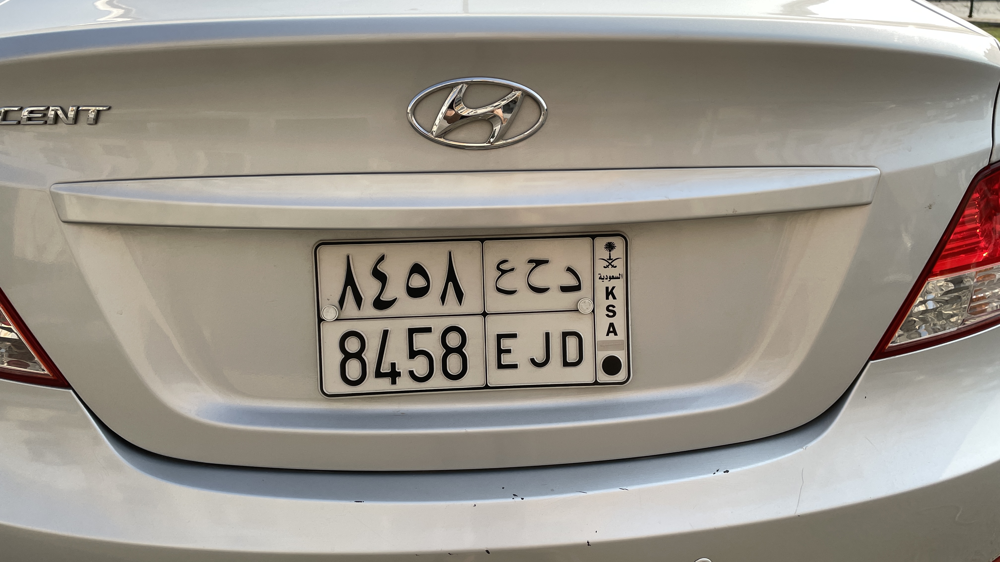

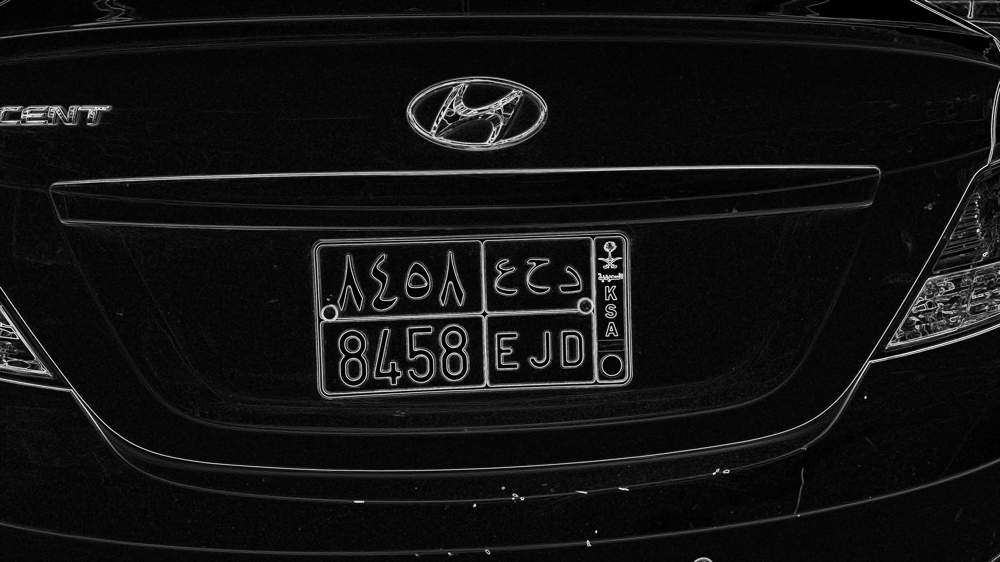

In [5]:
# هذا هو المسار الجديد بعد التعديل
dataset_dir = Path("C:/Users/johrh/Downloads/Projects_ Joharah/Projects Python/CAR/dataset")

filenames = dataset_dir.glob("*.jpg")
for fn in filenames:
    print(fn.name)
    img = cv.imread(str(fn))
    cv2_imshow(img)

    sobel_edges = sobel(img, L2gradient=True)
    cv2_imshow(sobel_edges)